In [1]:
# !pip install datasets
# !pip install cohere datasets numpy

In [2]:
import numpy as np
import tqdm

from datasets import load_dataset

In [3]:
lang = "ru" #Use the Simple English Wikipedia subset
docs = load_dataset("Cohere/wikipedia-2023-11-embed-multilingual-v3", lang, split="train", streaming=True)

Resolving data files:   0%|          | 0/138 [00:00<?, ?it/s]

In [4]:
# len(docs)  # doesnt work for streaming

In [5]:
import nltk
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('omw-1.4')

[nltk_data] Downloading package punkt to /home/shevkunov/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /home/shevkunov/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /home/shevkunov/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     /home/shevkunov/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [6]:
from nltk.tokenize import word_tokenize  
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string

from nltk.stem.porter import *

stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()
nltk_stop_words = set(stopwords.words("russian"))

def remove_punctuations(normalized_tokens):
    return [
        word
        for word in normalized_tokens
        if word not in string.punctuation
    ]

def normalizer(sentence):
    tokens = word_tokenize(sentence)

    #Stemming
    stemed_tokens = []
    for word in tokens:
        stemed_tokens.append(stemmer.stem(word))

    #Lemmatization
    nltk_lemma_list = []
    for word in stemed_tokens:
        nltk_lemma_list.append(lemmatizer.lemmatize(word))

        normalized_tokens = []  
    for w in nltk_lemma_list:  
        if w not in nltk_stop_words:  
            normalized_tokens.append(w)

    #Removing the punctuations
    normalized_tokens = remove_punctuations(normalized_tokens)
    return normalized_tokens

In [7]:
DOCS_LIMIT = 32768
DOCS_TEST  = 1024
TOKENS_LIMIT = 100

DOCS_TEST_CUTOFF = DOCS_LIMIT - DOCS_TEST

In [8]:
import collections
import tqdm

all_tokens = collections.Counter()
doc_tokens = list()
doc_texts  = list()
embs       = list()

for i, doc in tqdm.notebook.tqdm(enumerate(docs)):
    if i >= DOCS_LIMIT:
        break
    doc_id = doc['_id']
    title = doc['title']
    text = doc['text']
    emb = doc['emb']
    
    doc_texts.append(doc["title"] + " " + doc["text"])
    doc_tokens.append(normalizer(doc_texts[-1]))
    all_tokens.update(doc_tokens[-1])
    embs.append(emb)
        
embs = np.array(embs)
        
len(all_tokens), embs.shape

0it [00:00, ?it/s]

(176807, (32768, 1024))

In [9]:
token_2_id = {
    k: i
    for i, (k, v) in enumerate(all_tokens.most_common(TOKENS_LIMIT))
}

id_2_token = {
    v: k
    for k, v in token_2_id.items()
}

# token_2_id

In [10]:
all_tokens.most_common(TOKENS_LIMIT)

[('»', 20927),
 ('«', 20920),
 ('—', 18263),
 ('года', 13006),
 ('году', 9396),
 ('также', 3395),
 ('время', 2629),
 ('россии', 2075),
 ('2017', 2020),
 ('г.', 1959),
 ('это', 1896),
 ('который', 1864),
 ('области', 1821),
 ('её', 1699),
 ('год', 1627),
 ('стал', 1588),
 ('ссср', 1432),
 ('а.', 1396),
 ('лет', 1395),
 ('города', 1351),
 ('однако', 1310),
 ('является', 1296),
 ('в.', 1252),
 ('день', 1230),
 ('среди', 1207),
 ('против', 1207),
 ('1', 1192),
 ('2', 1192),
 ('фильм', 1186),
 ('реки', 1176),
 ('область', 1128),
 ('де', 1125),
 ('которые', 1097),
 ('состав', 1074),
 ('м.', 1051),
 ('3', 1040),
 ('войны', 1029),
 ('the', 1018),
 ('затем', 1006),
 ('составе', 1002),
 ('человек', 996),
 ('июня', 975),
 ('деревня', 950),
 ('марта', 941),
 ('годах', 940),
 ('июля', 938),
 ('километрах', 934),
 ('сша', 917),
 ('станция', 912),
 ('октября', 912),
 ('10', 911),
 ('мая', 907),
 ('сентября', 891),
 ('№', 886),
 ('получил', 877),
 ('место', 857),
 ('’', 856),
 ('августа', 855),
 ('мир

In [11]:
doc_tokens_ids = [
    [
        token_2_id[doc_tokes_i_j]
        for doc_tokes_i_j in doc_tokens_i
        if doc_tokes_i_j in token_2_id
    ]
    for doc_tokens_i in doc_tokens
]

# doc_tokens_ids

In [12]:
inverted_tags = dict()

inverted_tags["all"] = collections.defaultdict(list)

inverted_tags["train"] = collections.defaultdict(list)
inverted_tags["test"] = collections.defaultdict(list)

for i, doc_tokens_ids_i in enumerate(doc_tokens_ids):
    for token in set(doc_tokens_ids_i):
        inverted_tags["all"][token].append(i)
        inverted_tags["train" if i < DOCS_TEST_CUTOFF else "test"][token].append(i)
        
# inverted_tags

In [13]:
queries = list(token_2_id.values())
inverted = inverted_tags

len(queries) # , queries

100

In [14]:
import torch
from matplotlib import pyplot as plt
from torch import nn

from IPython.display import clear_output

In [15]:
doc_tokens_ids_set = [
    set(doc_tokens_ids_i)
    for doc_tokens_ids_i in doc_tokens_ids
]

def match(query, doc_id):
    return (query in doc_tokens_ids_set[doc_id])

In [16]:
total_inverted_count = 0
total_inverted_uniq_count = set()
for k, v in inverted_tags["all"].items():
    total_inverted_count += len(v)
    for v_i in v:
        total_inverted_uniq_count.add(v_i)
a, b = total_inverted_count, len(total_inverted_uniq_count)
print("total, uniq, frac = ", a, b, a / b)

total, uniq, frac =  132838 30880 4.301748704663212


In [28]:
# !pip install torch  # wtf?

device = torch.device('cuda:7')   
_ 

device(type='cuda', index=7)

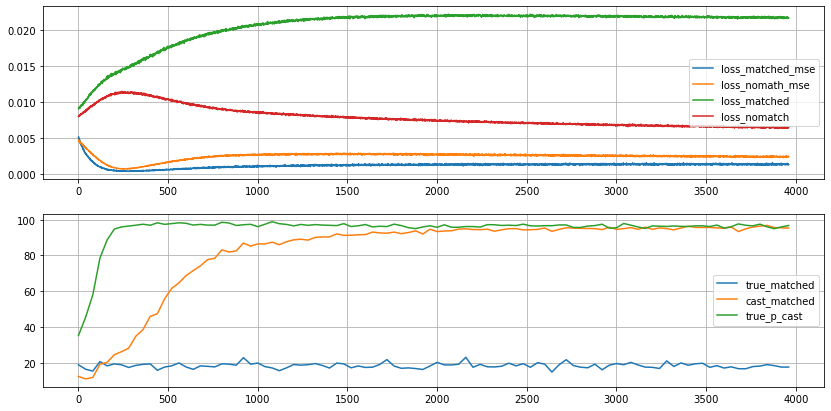

true_matched =  17.638383838383838  +-  0.7028996743844528
cast_matched =  95.46666666666667  +-  0.8900107704478134
true_p_cast =  96.35541238500154  +-  0.8200890547128854
fname =  mtest_2024-08-19 18:15:48.142087.npz


In [31]:
SAMPLES_LEN = 128
EPOCHS = 4000
DRAWS_TOTAL = 100
TOP_SIZE = 100
DRAW_DELAY = EPOCHS // DRAWS_TOTAL
D = 64

scalers = {
    "loss_matched_mse": +1,
    "loss_nomath_mse": +1,
    "loss_matched": -0.05,
    "loss_nomatch": +0.05
}


### Create Model

N = embs.shape[0]

e = torch.from_numpy(embs).to(device=device)
ed = nn.Embedding(N, D, max_norm=True, device=device)
eq = nn.Embedding(len(inverted["all"]), D, max_norm=True, device=device)  # all query embs

optimizer = torch.optim.Adam([*ed.parameters(), *eq.parameters()], lr=0.0001)

### Optimizer Run

elosses = collections.defaultdict(list)
mtest = collections.defaultdict(list)

for epoch in range(EPOCHS):
    losses = collections.defaultdict(list)
    for i, ql in enumerate(queries):
        optimizer.zero_grad()

        # + and - documents from all documents base (to train doc embs) ...            
        poss = np.random.choice(inverted_tags["all"][ql], SAMPLES_LEN)
        negs = list()
        while len(negs) < SAMPLES_LEN:
            doc_id = np.random.randint(0, DOCS_LIMIT)
            if not match(ql, doc_id):
                negs.append(doc_id)

        vs = np.concatenate([poss, np.array(negs)])

        # ... query from train
        true_query_emb = e[np.random.choice(inverted_tags["train"][ql])]
        
        query_emb = torch.concat([
            eq(torch.from_numpy(np.array(ql)).to(device=device)),
            true_query_emb
        ])
        query_emb = query_emb / ((query_emb * query_emb).sum() ** 0.5)
        
        true_doc_embds = e[vs]
        doc_embds = nn.functional.normalize(torch.concat([
            ed(torch.from_numpy(vs).to(device=device)),
            true_doc_embds
        ], dim=1))


        true_dist = true_doc_embds @ true_query_emb
        cast_dist = doc_embds @ query_emb
        
        
        matched_true = true_dist[:SAMPLES_LEN]
        matched_cast = cast_dist[:SAMPLES_LEN]
        
        nomatch_true = true_dist[SAMPLES_LEN:]
        nomatch_cast = cast_dist[SAMPLES_LEN:]
             
        _losses = {
            "loss_matched_mse": ((
                (matched_true - matched_true.mean())
                - (matched_cast - matched_cast.mean())
            ) ** 2).mean(),
            "loss_nomath_mse": ((
                (nomatch_true - nomatch_true.mean())
                - (nomatch_cast - nomatch_cast.mean())
            ) ** 2).mean(),
            "loss_matched": matched_cast.mean(),
            "loss_nomatch": nomatch_cast.mean()
        }

        loss = 0.
        for k, v in _losses.items():
            _add = v * scalers[k]
            losses[k].append(np.abs(_add.cpu().detach().numpy()))
            loss = loss + _add
            
        loss.backward()
        optimizer.step()
    
    ### Test Eval

    for k, v in losses.items():
        elosses[k].append(np.mean(v))

    if epoch % DRAW_DELAY != 0:
        continue
        
    ## Docs
    true_doc_embds = e
    doc_embds =  nn.functional.normalize(torch.concat([
        ed(torch.from_numpy(np.arange(len(embs))).to(device=device)),
        true_doc_embds
    ], dim=1))

    true_doc_embds.shape, doc_embds.shape

    ## Qs

    metrics = list()
    for i, ql in enumerate(queries):
        # query from test now ...
        if not inverted_tags["test"][ql]:
            # smth strange
            continue
            
        poss = np.random.choice(inverted_tags["test"][ql])

        true_query_emb = e[poss]
        query_emb = torch.concat([
            eq(torch.from_numpy(np.array(ql)).to(device=device)),
            true_query_emb
        ])
        query_emb = query_emb / ((query_emb * query_emb).sum() ** 0.5)

        true_top = (- true_doc_embds @ true_query_emb).argsort().cpu().numpy()
        cast_top = (- doc_embds @ query_emb).argsort().cpu().numpy()

        true_matched = [top_i for top_i in true_top[:TOP_SIZE] if match(ql, top_i)]
        cast_matched = [top_i for top_i in cast_top[:TOP_SIZE] if match(ql, top_i)]
        metrics.append([
            len(true_matched),
            len(cast_matched),
            1.0 * len(set(true_matched).intersection(set(cast_matched))) / max(len(true_matched), 1)
        ])

    _mtest = np.array(metrics).mean(axis=0)
    mtest["true_matched"].append(_mtest[0])
    mtest["cast_matched"].append(_mtest[1])
    mtest["true_p_cast"].append(100 * _mtest[2])
    
    clear_output(wait=True)
    
    ### Losses
    
    plt.figure(figsize=(14, 7))
    plt.subplot(211)
        
    for k, v in elosses.items():
        plt.plot(np.arange(epoch + 1), v, label=k)
    
    plt.grid()
    plt.legend()
    
    plt.subplot(212)
    
    for k, v in mtest.items():
        plt.plot(np.arange(0, epoch + 1, DRAW_DELAY), v, label=k)
    
    plt.grid()
    plt.legend()
    
    plt.show()
    
    
### Final Measurements

from datetime import datetime

for k, v in mtest.items():
    if v:
        print(f"{k} = ", np.mean(mtest[k][-10:]), " +- ", np.std(mtest[k][-10:]))
        
fname = f"mtest_{str(datetime.now())}.npz"

np.save(fname, mtest)
print("fname = ", fname)

In [32]:
torch.save(ed, fname + "_ed_.pt")
torch.save(eq, fname + "_eq_.pt")

In [33]:
!ls -lah | grep "_.pt"

-rw-rw-r--  1 shevkunov dpt_yandex_monetize_banner_adv_relevance_dep24304_dep87392 8.1M Aug 19 18:25 mtest_2024-08-19 18:15:48.142087.npz_ed_.pt
-rw-rw-r--  1 shevkunov dpt_yandex_monetize_banner_adv_relevance_dep24304_dep87392  28K Aug 19 18:25 mtest_2024-08-19 18:15:48.142087.npz_eq_.pt


In [35]:
## Docs
true_doc_embds = e
doc_embds =  nn.functional.normalize(torch.concat([
    ed(torch.from_numpy(np.arange(len(embs))).to(device=device)),
    true_doc_embds
], dim=1))

true_doc_embds.shape, doc_embds.shape

## Qs

TOP_SIZE = 100
metrics_ = list()

TOP_GRID = range(1, 101)
for TOP_SIZE in tqdm.notebook.tqdm(TOP_GRID):
    metrics = list()
    for i, ql in enumerate(queries):
        # query from test now ...
        if not inverted_tags["test"][ql]:
            # smth strange
            continue

        poss = np.random.choice(inverted_tags["test"][ql])

        true_query_emb = e[poss]
        query_emb = torch.concat([
            eq(torch.from_numpy(np.array(ql)).to(device=device)),
            true_query_emb
        ])
        query_emb = query_emb / ((query_emb * query_emb).sum() ** 0.5)

        true_top = (- true_doc_embds @ true_query_emb).argsort().cpu().numpy()
        cast_top = (- doc_embds @ query_emb).argsort().cpu().numpy()

        true_matched = [top_i for top_i in true_top[:TOP_SIZE] if match(ql, top_i)]
        cast_matched = [top_i for top_i in cast_top[:TOP_SIZE] if match(ql, top_i)]
        metrics.append([
            
            len(true_matched),
            len(cast_matched),
            1.0 * len(set(true_matched).intersection(set(cast_matched))) / max(len(true_matched), 1)
        ])
    metrics_.append(np.mean(metrics, axis=0))
    
metrics_ = np.array(metrics_)

  0%|          | 0/100 [00:00<?, ?it/s]

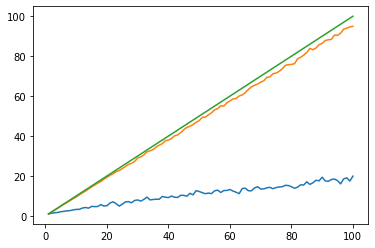

In [36]:
plt.plot(TOP_GRID, metrics_[:, 0])
plt.plot(TOP_GRID, metrics_[:, 1])
plt.plot(TOP_GRID, TOP_GRID)

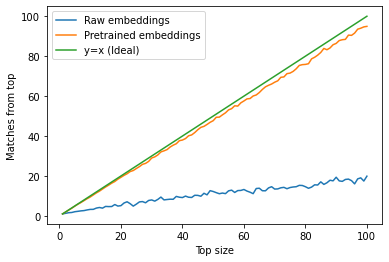

In [37]:
plt.plot(TOP_GRID, metrics_[:, 0], label="Raw embeddings")
plt.plot(TOP_GRID, metrics_[:, 1], label="Pretrained embeddings")
plt.xlabel("Top size")
plt.ylabel("Matches from top")
plt.plot(TOP_GRID, TOP_GRID, label="y=x (Ideal)")
plt.legend()
plt.show()

In [ ]:
plt.plot(TOP_GRID, metrics_[:, 0], label=r"$V_i$")
plt.plot(TOP_GRID, metrics_[:, 1], label=r"\hat{V_i}")
plt.xlabel("Размер топа")
plt.ylabel("Матчится на метку")
plt.plot(TOP_GRID, TOP_GRID, label="y=x (Идеал)")
plt.legend()
plt.show()

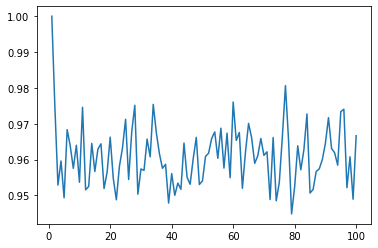

In [38]:
plt.plot(TOP_GRID, metrics_[:, 2])

# Clusters

In [40]:
true_doc_embds = e
doc_embds =  nn.functional.normalize(torch.concat([
    ed(torch.from_numpy(np.arange(len(embs))).to(device=device)),
    true_doc_embds
], dim=1))

doc_embds.shape

torch.Size([32768, 1088])

In [41]:
from sklearn import manifold


tsne = manifold.TSNE(n_components=2, random_state=0)
doc_embds_nmpy = doc_embds.detach().cpu().numpy()
doc_embds_flat = tsne.fit_transform(doc_embds_nmpy)

doc_embds_flat.shape

/home/shevkunov/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/shevkunov/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


(32768, 2)

In [42]:
from sklearn import manifold


tsne = manifold.TSNE(n_components=2, random_state=0)
embs_flat_nmpy = true_doc_embds.detach().cpu().numpy()
embs_flat = tsne.fit_transform(embs_flat_nmpy)

embs_flat.shape

/home/shevkunov/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/shevkunov/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


(32768, 2)

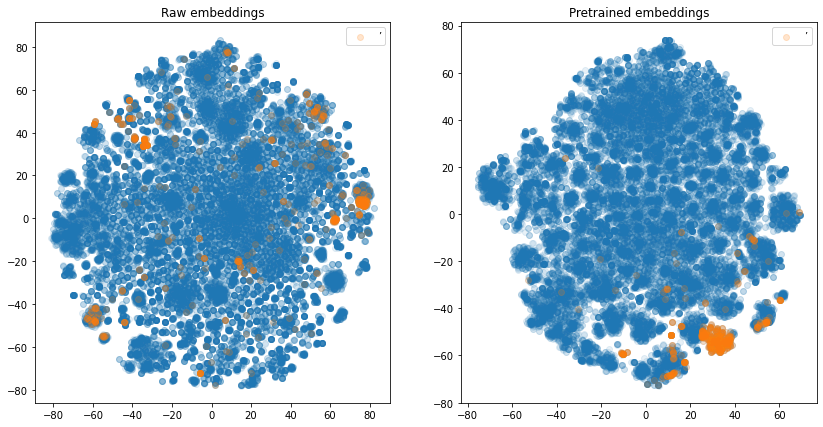

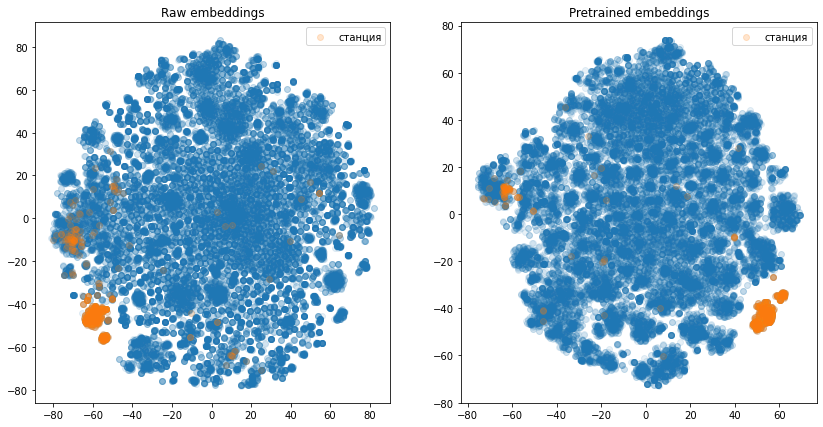

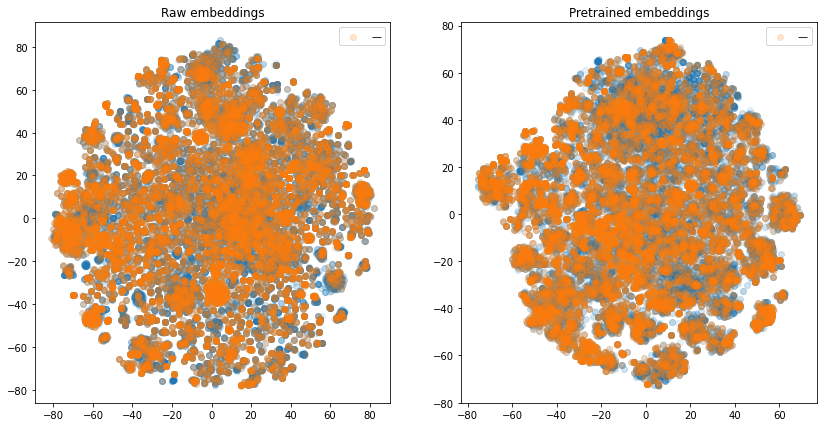

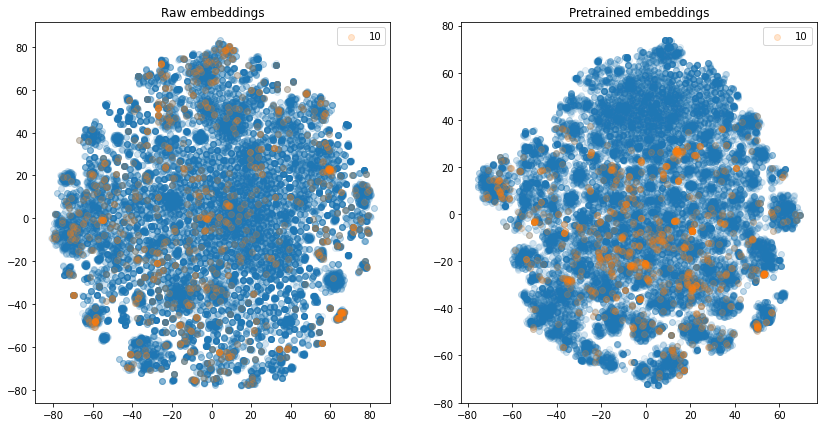

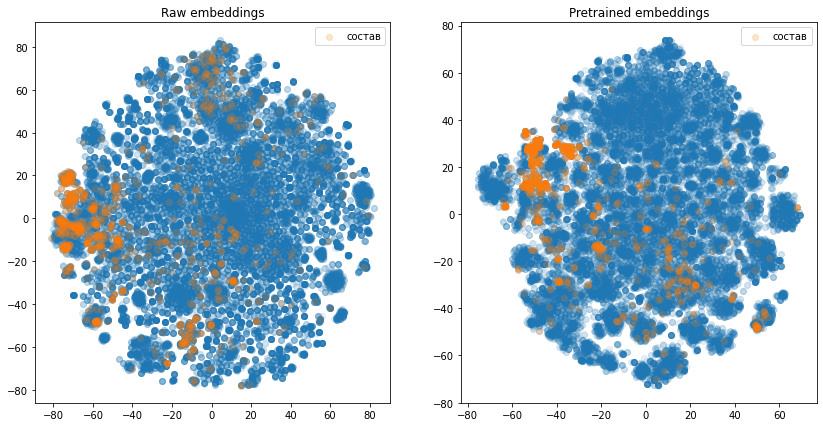

...

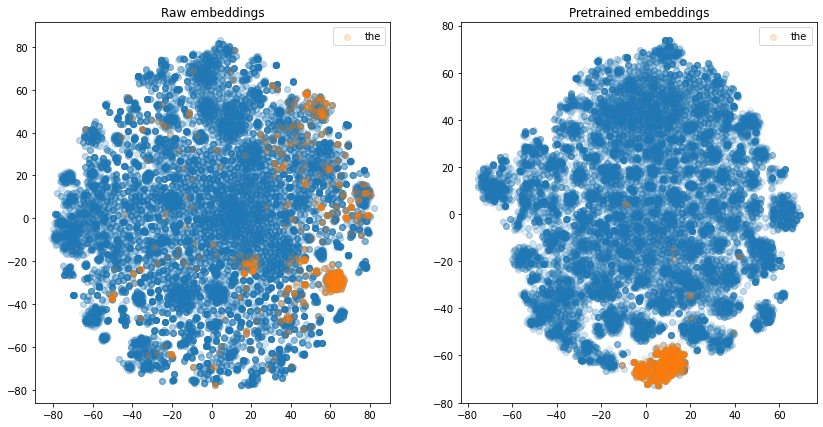

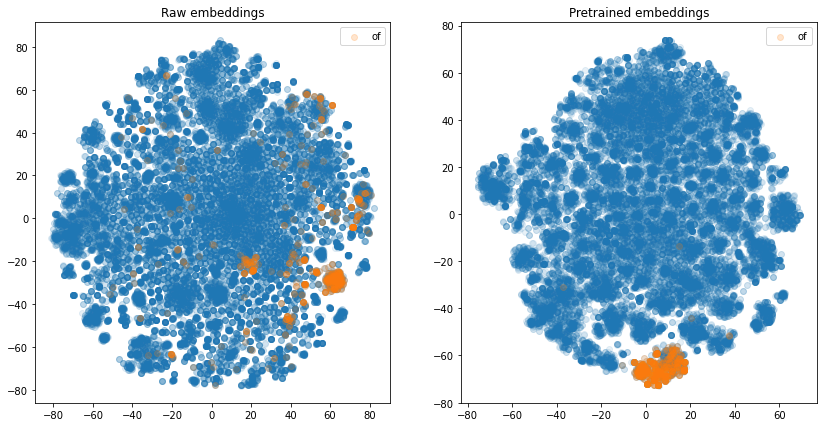

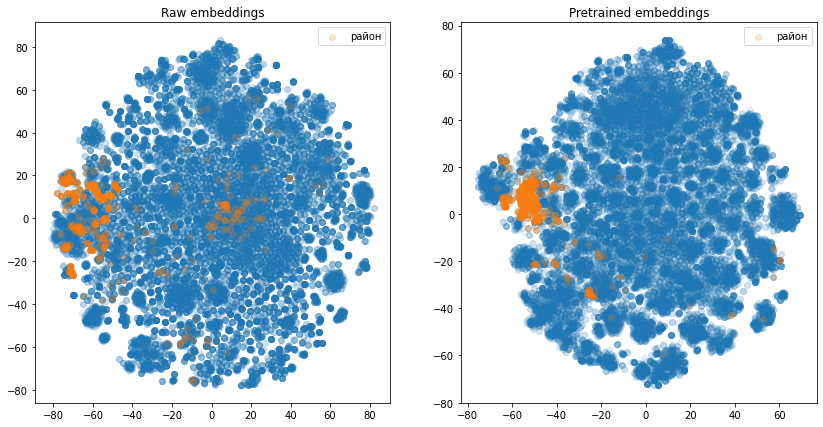

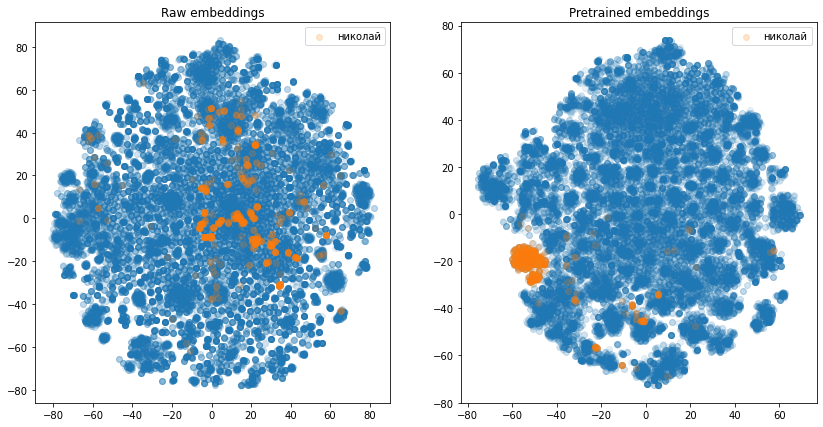

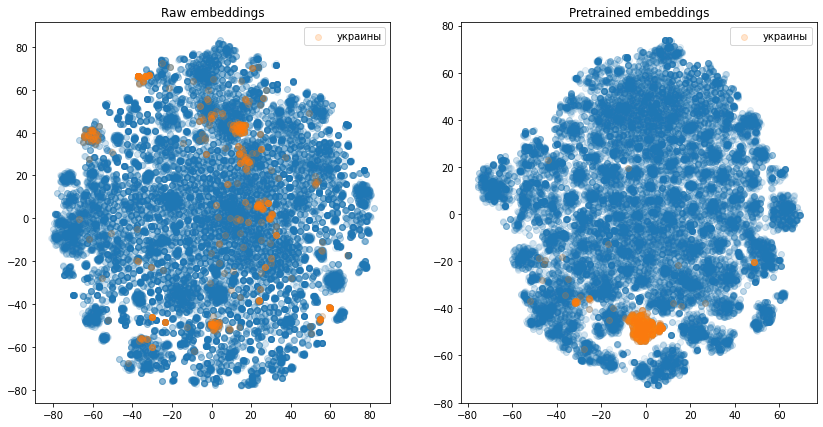

In [43]:
from sklearn.linear_model import Ridge

for i, (k, v) in enumerate(inverted_tags["all"].items()):
    plt.figure(figsize=(14, 7))
    plt.subplot(121)
    
    plt.scatter(embs_flat[:, 0], embs_flat[:, 1], alpha=0.1)

    embs_flat_ = embs_flat[v]
    plt.scatter(embs_flat_[:, 0], embs_flat_[:, 1], label=id_2_token[k], alpha=0.2)
    
    plt.title("Raw embeddings")
    plt.legend()
    
    
    plt.subplot(122)
    plt.scatter(doc_embds_flat[:, 0], doc_embds_flat[:, 1], alpha=0.1)

    embs_flat_ = doc_embds_flat[v]
    plt.scatter(embs_flat_[:, 0], embs_flat_[:, 1], label=id_2_token[k], alpha=0.2)
    

    plt.title("Pretrained embeddings")
    plt.legend()
    plt.show()


In [46]:
from sklearn.linear_model import Ridge
from sklearn.metrics import accuracy_score, roc_auc_score

rows = list()
for i, (k, v) in enumerate(inverted_tags["all"].items()):
    y = [id_2_token[k] in doc_tokens_i for doc_tokens_i in doc_tokens]
    r = Ridge(alpha = 0)
    r.fit(embs_flat_nmpy, y)  # true_doc_embds, y)
    auc_before = roc_auc_score(y, r.predict(embs_flat_nmpy)) # true_doc_embds))
    
    r = Ridge(alpha = 0)
    r.fit(doc_embds_nmpy, y)
    auc_after = roc_auc_score(y, r.predict(doc_embds_nmpy))
    
    rows.append((k, id_2_token[k], auc_before, auc_after))
    print(*rows[-1])

56 ’ 0.9675150216730387 0.9999997256716271
48 станция 0.9935680450743682 0.9998945670023989
2 — 0.916438099072078 0.9197374285905607
50 10 0.9185982349742281 0.9999839294580792
33 состав 0.9562170759639832 0.9999043988089223
3 года 0.9318916121671226 0.9454114780178673
39 составе 0.9504943542379327 0.9998680486743173
45 июля 0.9472207808176555 0.9999870529123622
52 сентября 0.9493123356242892 0.999959792529452
35 3 0.9084311391561516 0.9999763376543114
6 время 0.8804196097075263 0.9974756913523071
49 октября 0.958609929626419 0.9999626184506011
4 году 0.9442851726243393 0.9529866119747072
40 человек 0.9737777429920428 0.999955976610554
55 место 0.9197377453162395 0.9999974234053944
31 де 0.9839481301065187 0.9999873896964716
0 » 0.9332125139908667 0.9526258816000758
1 « 0.9331671765985607 0.9526723470831692
8 2017 0.9938820200700517 0.9996207778566308
54 получил 0.9446359249874874 0.9999926097972973
28 фильм 0.9977015795664267 0.99999568145676
18 лет 0.9536112437265902 0.99985784404620

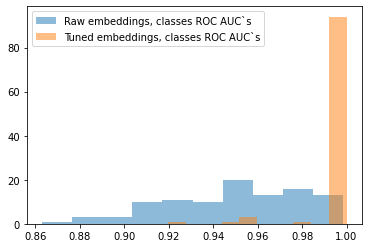

In [47]:
plt.hist(np.array(rows)[:, 2].astype(float), alpha=0.5, label="Raw embeddings, classes ROC AUC`s")
plt.hist(np.array(rows)[:, 3].astype(float), alpha=0.5, label="Tuned embeddings, classes ROC AUC`s")
plt.legend()

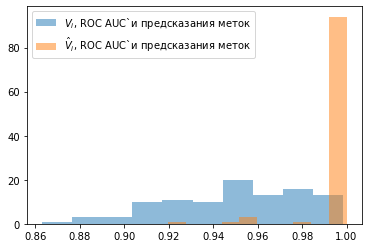

In [48]:
plt.hist(np.array(rows)[:, 2].astype(float), alpha=0.5, label=r"$V_i$, ROC AUC`и предсказания меток")
plt.hist(np.array(rows)[:, 3].astype(float), alpha=0.5, label=r"$\hat{V}_i$, ROC AUC`и предсказания меток")
plt.legend()

In [49]:
sorted(rows, key = lambda x : x[3] - x[2])

[(68, '//', 0.9984000784679418, 0.9998240473284256),
 (28, 'фильм', 0.9977015795664267, 0.99999568145676),
 (2, '—', 0.916438099072078, 0.9197374285905607),
 (29, 'реки', 0.9954141601663403, 0.9995043411541245),
 (42, 'деревня', 0.9954928179646922, 0.9998776120676112),
 (46, 'километрах', 0.9948730354776132, 0.9994892481651858),
 (91, 'родился', 0.9945472167316577, 0.9999762609073038),
 (8, '2017', 0.9938820200700517, 0.9996207778566308),
 (83, '2018', 0.9937481884552326, 0.9999998617141399),
 (48, 'станция', 0.9935680450743682, 0.9998945670023989),
 (95, 'украины', 0.9923721165208951, 0.9999997684696399),
 (4, 'году', 0.9442851726243393, 0.9529866119747072),
 (93, 'николай', 0.9898754346887444, 0.9999989242755007),
 (64, '2016', 0.9865936335056487, 0.999988196099757),
 (3, 'года', 0.9318916121671226, 0.9454114780178673),
 (36, 'войны', 0.9850031005753963, 0.9999631015006124),
 (72, 'of', 0.9826607304954992, 0.998655042401839),
 (31, 'де', 0.9839481301065187, 0.9999873896964716),
 (16,

In [50]:
sorted(rows, key = lambda x : x[3])

[(2, '—', 0.916438099072078, 0.9197374285905607),
 (3, 'года', 0.9318916121671226, 0.9454114780178673),
 (0, '»', 0.9332125139908667, 0.9526258816000758),
 (1, '«', 0.9331671765985607, 0.9526723470831692),
 (4, 'году', 0.9442851726243393, 0.9529866119747072),
 (5, 'также', 0.8630674820812709, 0.9836450911720259),
 (6, 'время', 0.8804196097075263, 0.9974756913523071),
 (37, 'the', 0.9797968896311556, 0.9982347410108214),
 (72, 'of', 0.9826607304954992, 0.998655042401839),
 (19, 'города', 0.960895966632853, 0.9989797410298151),
 (22, 'в.', 0.9601028436141401, 0.9991832435931249),
 (17, 'а.', 0.9692854669594165, 0.9992581131865321),
 (46, 'километрах', 0.9948730354776132, 0.9994892481651858),
 (14, 'год', 0.8893973437369551, 0.9994927576145248),
 (29, 'реки', 0.9954141601663403, 0.9995043411541245),
 (7, 'россии', 0.9750631613701852, 0.9995727634361797),
 (15, 'стал', 0.9311041415775909, 0.999601502711718),
 (11, 'который', 0.8767613433094458, 0.9996127051649456),
 (8, '2017', 0.993882020

In [51]:
sorted(rows, key = lambda x : x[2])

[(5, 'также', 0.8630674820812709, 0.9836450911720259),
 (11, 'который', 0.8767613433094458, 0.9996127051649456),
 (6, 'время', 0.8804196097075263, 0.9974756913523071),
 (14, 'год', 0.8893973437369551, 0.9994927576145248),
 (61, 'которой', 0.8966152095139805, 0.999988058556651),
 (27, '2', 0.8992095322649365, 0.9998525459916073),
 (26, '1', 0.9028838918419009, 0.9998999061513483),
 (24, 'среди', 0.9058760153433867, 0.9999355680520896),
 (69, 'которая', 0.9061561057145731, 0.9999949246332202),
 (10, 'это', 0.9076069377080753, 0.999813475683904),
 (35, '3', 0.9084311391561516, 0.9999763376543114),
 (63, '4', 0.9093935054271467, 0.9999629978585359),
 (9, 'г.', 0.9107093437765693, 0.9998323956346482),
 (32, 'которые', 0.9119056051685163, 0.9999856747032532),
 (80, 'несколько', 0.9162085367078572, 0.999975228575772),
 (2, '—', 0.916438099072078, 0.9197374285905607),
 (75, 'которых', 0.9166226346666088, 0.999992426372507),
 (60, '5', 0.9177139584096978, 0.9999608908339673),
 (38, 'затем', 0.9